# Predictive Brain Tumor Image AI Project - Data Wrangling & EDA

To make an image-processing brain tumor predictive model to automate on scale.

# Brain Tumor info and labeling

Brain MRI info
- Glioma: A type of cancer arising from glial cells in the brain or spinal cord.
- Meningioma: Usually a benign tumor from the meninges; rarely malignant.
- Notumor: Means no tumor was found.
- Pituitary: Refers to the gland; tumors (mostly benign) can form, rarely cancerous.

So I am thinking of making one model only have 2 binary classification with this type of labeling:
- Glioma classified as cancer in training 
- and Notumor (no tumor), Meningioma, and Pituitary as no cancer in training

# PyImage Folder Structure

We will most likely be using pytorch and it's dataloader, and that system likes to have subfolders which the data loader will use the subfolders name to apply labels to each of the images during training and testing.

# Handle Data Split

So the data is originally split up into train and test folders but I intentionally make a duplicate new folder of them merged together. The reason for merging is to make it easier to do cross validation.

I will give both the separated and merge data folders to make it flexible to experiment between the 2.

# Initial Setup

In [103]:

from IPython.display import Image as PyImage

import os
import hashlib
from PIL import Image as PILImage
from PIL import ImageOps
from statistics import mode, StatisticsError

import torch
from torchvision.utils import save_image
from torchvision import datasets, transforms
from torch.utils.data import DataLoader

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from collections import Counter

import cv2

In [94]:
# Code to delete a list of images based on file paths

def delete_images(file_paths):
    for file_path in file_paths:
        if os.path.exists(file_path):
            try:
                os.remove(file_path)
                print(f"Successfully deleted: {file_path}")
            except Exception as e:
                print(f"Error deleting {file_path}: {e}")
        else:
            print(f"File not found: {file_path}")

In [2]:
ImageDataMergePath = './ImageData-Merge'

# Check for corrupted images

In [3]:
def scan_images_for_corruption(directory, delete_corrupted=False):
    """
    Scans all image files in the given directory to check for corruption.
    Optionally deletes corrupted images if specified.

    Parameters:
        directory (str): Path to the directory to scan.
        delete_corrupted (bool): If True, deletes corrupted images. Defaults to False.

    Returns:
        tuple: Number of images scanned, number of corrupted images.
    """
    total_files_scanned = 0
    corrupted_images = 0

    # Supported image extensions
    supported_extensions = {".jpg", ".jpeg", ".png", ".bmp", ".gif", ".tiff"}

    for root, _, files in os.walk(directory):
        for file in files:
            file_path = os.path.join(root, file)
            ext = os.path.splitext(file)[1].lower()

            if ext in supported_extensions:
                total_files_scanned += 1
                try:
                    with PILImage.open(file_path) as img:
                        img.verify()  # Verify the image integrity
                except Exception:
                    corrupted_images += 1
                    print(f"Corrupted image found: {file_path}")
                    if delete_corrupted:
                        try:
                            os.remove(file_path)
                            print(f"Deleted corrupted image: {file_path}")
                        except Exception as e:
                            print(f"Failed to delete corrupted image: {file_path}. Error: {e}")

    print(f"Total files scanned: {total_files_scanned}")
    print(f"Total corrupted images: {corrupted_images}")

    return total_files_scanned, corrupted_images

In [4]:
corrupted_images = scan_images_for_corruption(ImageDataMergePath, delete_corrupted=False)

Total files scanned: 7023
Total corrupted images: 0


Looks like none of the images have image corruption. That is good.

In [5]:
# remove corrupted images
    # not needed as no images are corrupted

# scan_images_for_corruption(ImageDataTogetherPath, remove_corrupted=True)

# Duplicate Image

In [6]:
def get_file_hash(file_path):
    """Calculate the MD5 hash of a file."""
    hash_func = hashlib.md5()
    with open(file_path, 'rb') as f:
        while chunk := f.read(8192):
            hash_func.update(chunk)
    return hash_func.hexdigest()

def find_duplicates(directory, delete_duplicates=False):
    """Find and optionally delete duplicate files in a directory."""
    hashes = {}
    duplicates = []
    total_files_scanned = 0
    files_deleted = 0

    for root, _, files in os.walk(directory):
        for file in files:
            file_path = os.path.join(root, file)
            total_files_scanned += 1
            file_hash = get_file_hash(file_path)
            if file_hash in hashes:
                duplicates.append((file_path, hashes[file_hash]))
                if delete_duplicates:
                    os.remove(file_path)
                    files_deleted += 1
            else:
                hashes[file_hash] = file_path

    total_files_left = total_files_scanned - files_deleted

    print(f"Total files scanned: {total_files_scanned}")
    print(f"Duplicates found: {len(duplicates)}")
    if delete_duplicates:
        print(f"Files deleted: {files_deleted}")
        print(f"Files left: {total_files_left}")

    return duplicates

In [7]:
duplicates = find_duplicates(ImageDataMergePath, delete_duplicates=False)

for dup in duplicates:
    print(f"Duplicate found: {dup[0]} and {dup[1]}")

# Check the folder and there are 297 duplicates.

Total files scanned: 7023
Duplicates found: 297
Duplicate found: ./ImageData-Merge\glioma\Te-gl_0029.jpg and ./ImageData-Merge\glioma\Te-gl_0024.jpg
Duplicate found: ./ImageData-Merge\meningioma\Te-me_0031.jpg and ./ImageData-Merge\meningioma\Te-me_0010.jpg
Duplicate found: ./ImageData-Merge\meningioma\Te-me_0073.jpg and ./ImageData-Merge\meningioma\Te-me_0071.jpg
Duplicate found: ./ImageData-Merge\meningioma\Tr-me_0071.jpg and ./ImageData-Merge\meningioma\Te-me_0135.jpg
Duplicate found: ./ImageData-Merge\meningioma\Tr-me_0211.jpg and ./ImageData-Merge\meningioma\Tr-me_0176.jpg
Duplicate found: ./ImageData-Merge\meningioma\Tr-me_0238.jpg and ./ImageData-Merge\meningioma\Tr-me_0227.jpg
Duplicate found: ./ImageData-Merge\meningioma\Tr-me_0251.jpg and ./ImageData-Merge\meningioma\Tr-me_0249.jpg
Duplicate found: ./ImageData-Merge\meningioma\Tr-me_0281.jpg and ./ImageData-Merge\meningioma\Tr-me_0175.jpg
Duplicate found: ./ImageData-Merge\meningioma\Tr-me_0283.jpg and ./ImageData-Merge\menin

In [8]:
duplicate_sample_width = 256

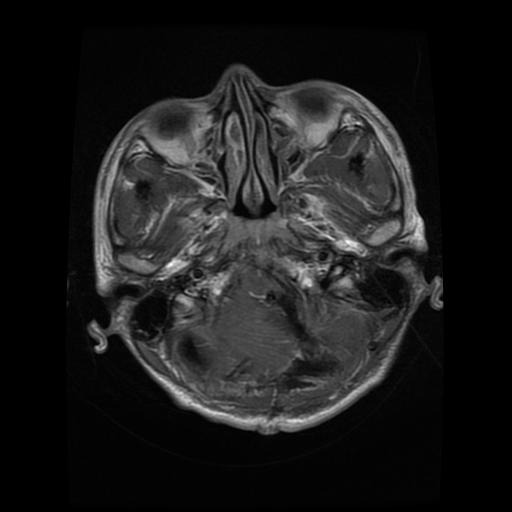

In [9]:
PyImage(filename='./ImageData-Merge\glioma\Te-gl_0029.jpg', width=duplicate_sample_width)

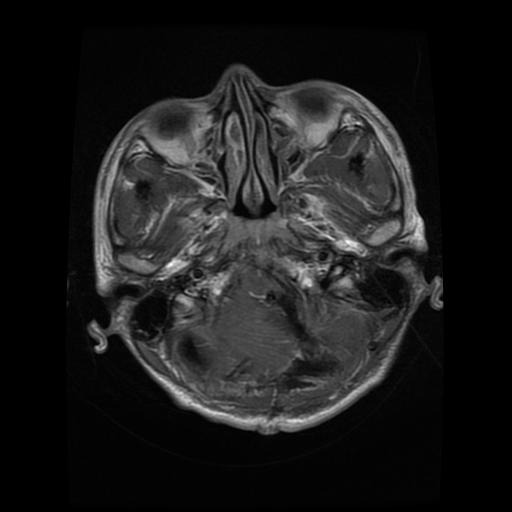

In [10]:
PyImage(filename='./ImageData-Merge\glioma\Te-gl_0024.jpg', width=duplicate_sample_width)

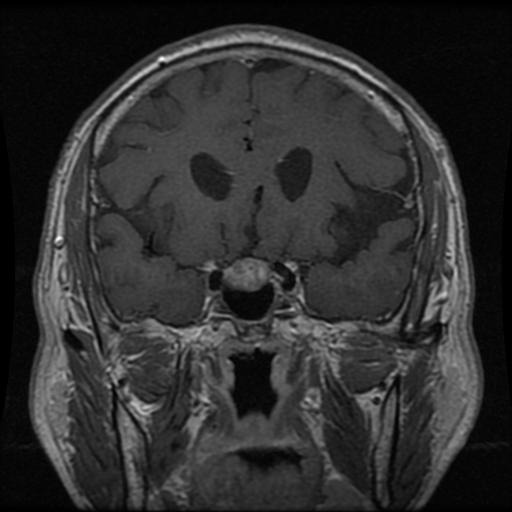

In [11]:
PyImage(filename='./ImageData-Merge\pituitary\Tr-pi_0668.jpg', width=duplicate_sample_width)

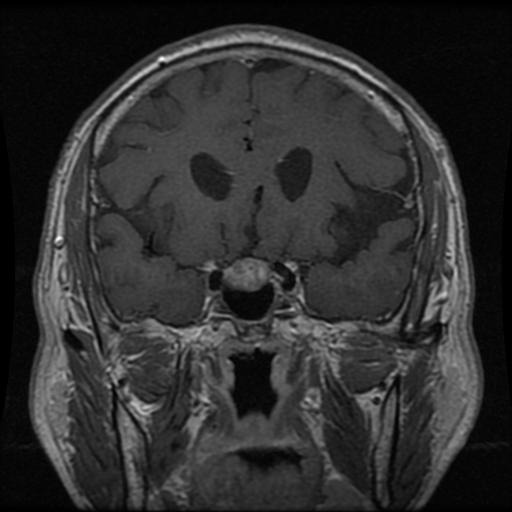

In [12]:
PyImage(filename='./ImageData-Merge\pituitary\Te-pi_0045.jpg', width=duplicate_sample_width)

In [13]:
# all the sample images look like duplicates to me, so going to delete them.

duplicates = find_duplicates(ImageDataMergePath, delete_duplicates=True)

Total files scanned: 7023
Duplicates found: 297
Files deleted: 297
Files left: 6726


# Exploring the images in each subfolder

For each folder / class I will be showing both the first image and a screen shot of file sample 

In [14]:
viewing_single_image_width = 256
viewing_sample_screenshot_image_width = 1920

## Glioma - Lethal Cancer

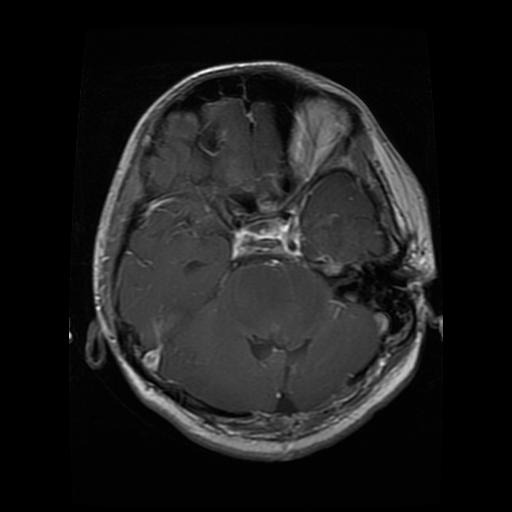

In [15]:
PyImage(filename='./ImageData-Merge/glioma/Te-gl_0010.jpg', width=viewing_single_image_width)

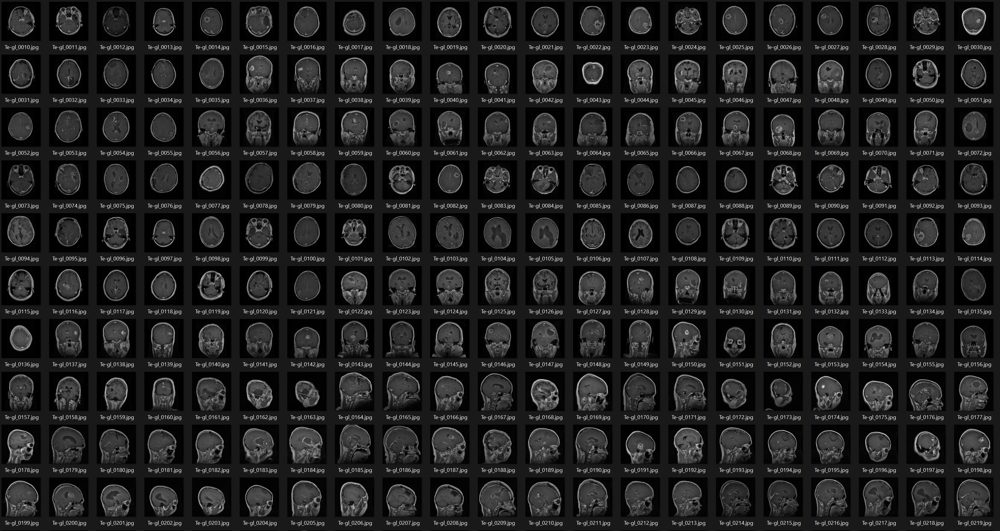

In [16]:
PyImage(filename='./ImageData-SampleScreenshot/glioma_sample_Screenshot.png', width=viewing_sample_screenshot_image_width)

## Meningioma - benign meninges tumor

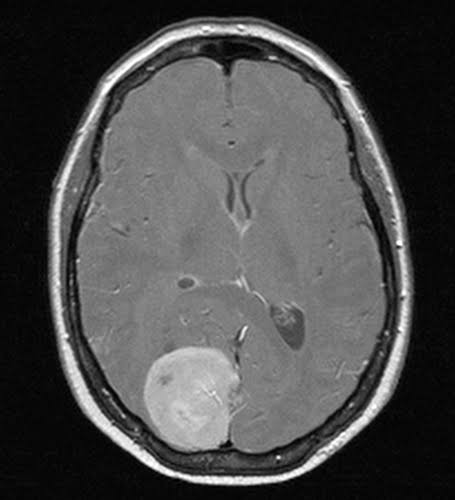

In [17]:
PyImage(filename='./ImageData-Merge/meningioma/Te-me_0010.jpg', width=viewing_single_image_width)

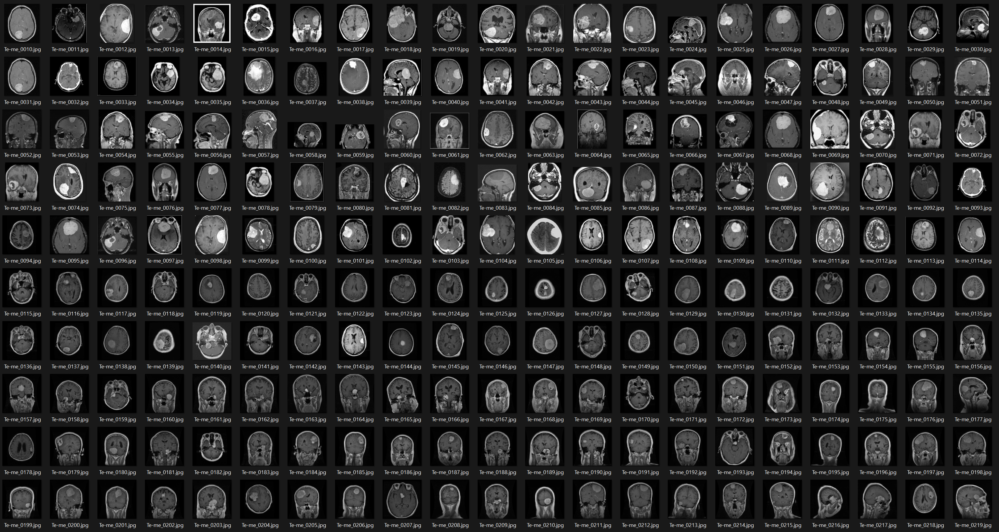

In [18]:
PyImage(filename='./ImageData-SampleScreenshot/meningioma_sample_Screenshot.png', width=viewing_sample_screenshot_image_width)

## No Tumor

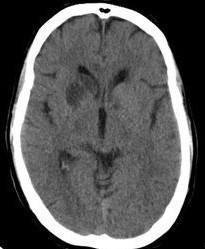

In [19]:
# notumor
PyImage(filename='./ImageData-Merge/notumor/Te-no_0010.jpg', width=viewing_single_image_width)

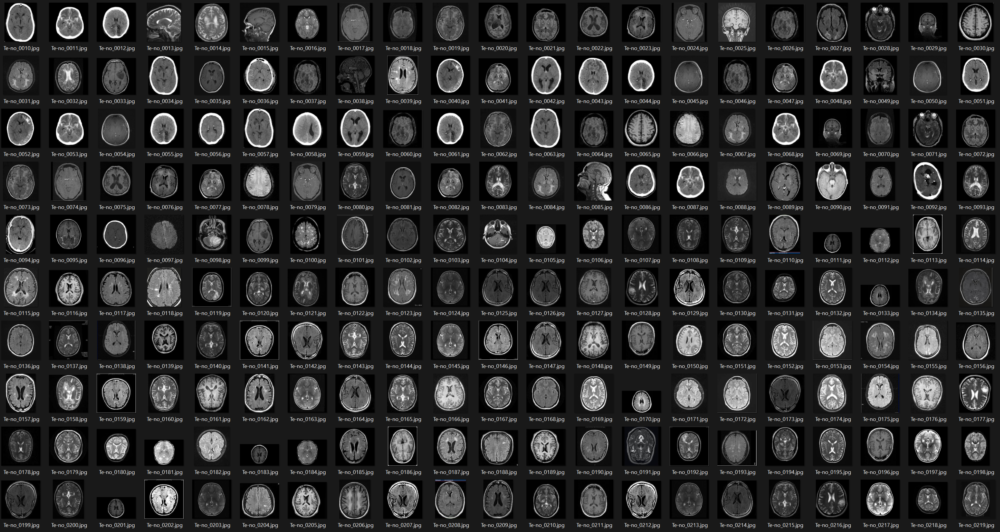

In [20]:
PyImage(filename='./ImageData-SampleScreenshot/notumor_sample_Screenshot.png', width=viewing_sample_screenshot_image_width)

## Pituitary - benign tumors

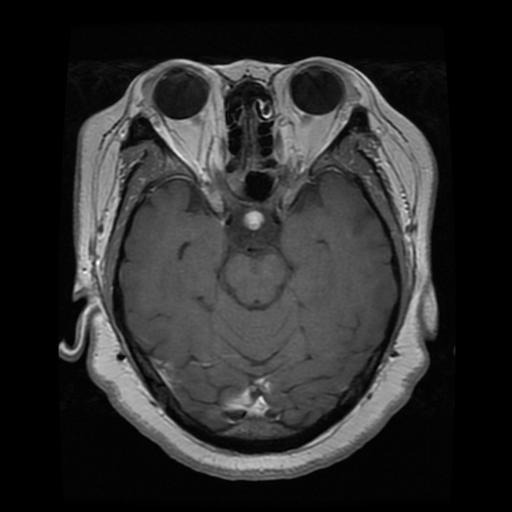

In [21]:
PyImage(filename='./ImageData-Merge/pituitary/Te-pi_0010.jpg', width=viewing_single_image_width)

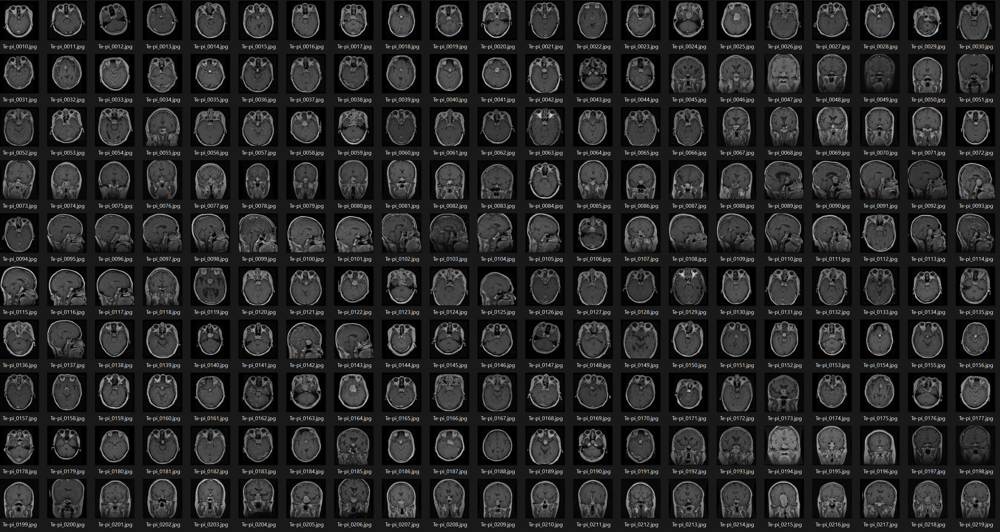

In [22]:
PyImage(filename='./ImageData-SampleScreenshot/pituitary_sample_Screenshot.png', width=viewing_sample_screenshot_image_width)

## Discovery

Overall, all the images at a glance looks good.

# Image Metadata

In [23]:
def analyze_file_type(folder_path):
    """
    Scans through all image files in a folder, prints the count of file types,
    and returns a list of file paths with unusual extensions.
    
    Args:
        folder_path (str): Path to the folder containing image files.
        
    Returns:
        list: List of file paths considered outliers due to unusual extensions.
    """
    file_types = []
    total_files = 0
    file_paths = []
    for root, _, files in os.walk(folder_path):
        for file in files:
            total_files += 1
            _, ext = os.path.splitext(file)
            file_types.append(ext.lower())
            file_paths.append(os.path.join(root, file))
    
    counts = Counter(file_types)
    print(f'Total files scanned: {total_files}')
    print(f'File type counts: {counts}')
    
    # Identify outlier file types
    outliers = [path for path, ext in zip(file_paths, file_types) if counts[ext] == 1]
    return outliers


def analyze_file_size(folder_path, unit="KB"):
    """
    Scans through all image files in a folder, provides descriptive stats for file sizes, 
    and identifies outliers based on file size.

    Args:
        folder_path (str): Path to the folder containing image files.
        unit (str): Unit for the file size stats ('Bytes', 'KB', 'MB', or 'GB').
                   Default is 'KB'.

    Returns:
        list: A list of file paths considered outliers in file size.
    """
    file_sizes = []
    file_paths = []
    total_files = 0
    for root, _, files in os.walk(folder_path):
        for file in files:
            total_files += 1
            file_path = os.path.join(root, file)
            if os.path.isfile(file_path):
                file_size = os.path.getsize(file_path)
                file_sizes.append(file_size)
                file_paths.append(file_path)

    # Conversion factors
    unit_conversion = {
        "Bytes": 1,
        "KB": 1024,
        "MB": 1024 ** 2,
        "GB": 1024 ** 3
    }

    if unit not in unit_conversion:
        raise ValueError(f"Invalid unit '{unit}'. Choose from 'Bytes', 'KB', 'MB', or 'GB'.")

    conversion_factor = unit_conversion[unit]

    print(f"Total files scanned: {total_files}\n")

    outlier_paths = []
    if file_sizes:
        mean_size = np.mean(file_sizes)
        std_dev_size = np.std(file_sizes)
        lower_bound = mean_size - 3 * std_dev_size
        upper_bound = mean_size + 3 * std_dev_size

        for i, size in enumerate(file_sizes):
            if size < lower_bound or size > upper_bound:
                outlier_paths.append(file_paths[i])

        try:
            mode_size = mode(file_sizes) / conversion_factor
        except StatisticsError:  # Handle no unique mode
            mode_size = None

        print(f"File Size Statistics ({unit}):")
        print(f"- Min size: {min(file_sizes) / conversion_factor:.2f} {unit}")
        print(f"- Max size: {max(file_sizes) / conversion_factor:.2f} {unit}")
        print(f"- Mean size: {mean_size / conversion_factor:.2f} {unit}")
        print(f"- Median size: {np.median(file_sizes) / conversion_factor:.2f} {unit}")
        print(f"- Std deviation: {std_dev_size / conversion_factor:.2f} {unit}")
        print(f"- Mode size: {mode_size:.2f} {unit}" if mode_size else "- Mode size: None")
    else:
        print("No files found.")

    print()
    print(f"Total Outliers found: {len(outlier_paths)}")
    
    return outlier_paths


def analyze_file_dimensions(folder_path):
    """
    Scans through all image files in a folder, provides a count of dimensions,
    descriptive stats for dimensions, and identifies outliers based on horizontal (width) dimensions.

    Args:
        folder_path (str): Path to the folder containing image files.

    Returns:
        list: A list of file paths considered outliers in width dimensions.
    """
    dimensions = []
    file_paths = []
    total_files = 0
    for root, _, files in os.walk(folder_path):
        for file in files:
            total_files += 1
            file_path = os.path.join(root, file)
            try:
                with PILImage.open(file_path) as img:
                    dimensions.append(img.size)  # (width, height)
                    file_paths.append(file_path)
            except Exception:
                continue  # Skip non-image files or unsupported formats

    dimension_counts = Counter(dimensions)
    # Sort dimension counts in descending order
    sorted_dimension_counts = dict(sorted(dimension_counts.items(), key=lambda x: x[1], reverse=True))

    print(f"Total files scanned: {total_files}\n")

    outlier_paths = []
    if dimensions:
        width_stats = [dim[0] for dim in dimensions]
        height_stats = [dim[1] for dim in dimensions]

        mean_width = np.mean(width_stats)
        std_dev_width = np.std(width_stats)
        lower_bound = mean_width - 3 * std_dev_width
        upper_bound = mean_width + 3 * std_dev_width

        for i, width in enumerate(width_stats):
            if width < lower_bound or width > upper_bound:
                outlier_paths.append(file_paths[i])

        try:
            mode_width = mode(width_stats)
        except StatisticsError:  # Handle no unique mode
            mode_width = None

        try:
            mode_height = mode(height_stats)
        except StatisticsError:  # Handle no unique mode
            mode_height = None

        print("Dimension Counts:")
        for dimension, count in sorted_dimension_counts.items():
            print(f"- {dimension}: {count} files")

        print("\nWidth Statistics:")
        print(f"- Min width: {min(width_stats)}")
        print(f"- Max width: {max(width_stats)}")
        print(f"- Mean width: {mean_width:.2f}")
        print(f"- Median width: {np.median(width_stats):.2f}")
        print(f"- Std deviation: {std_dev_width:.2f}")
        print(f"- Mode width: {mode_width}" if mode_width else "- Mode width: None")

        print("\nHeight Statistics:")
        print(f"- Min height: {min(height_stats)}")
        print(f"- Max height: {max(height_stats)}")
        print(f"- Mean height: {np.mean(height_stats):.2f}")
        print(f"- Median height: {np.median(height_stats):.2f}")
        print(f"- Std deviation: {np.std(height_stats):.2f}")
        print(f"- Mode height: {mode_height}" if mode_height else "- Mode height: None")
    else:
        print("No dimensions found.")

    print()
    print(f"Total Outliers found: {len(outlier_paths)}")

    return outlier_paths


## Checking the entire folder

In [24]:
analyze_file_type(ImageDataMergePath)

# Looks like all the images are jpg so no need to convert any of them

Total files scanned: 6726
File type counts: Counter({'.jpg': 6726})


[]

In [25]:
file_size_outliers = analyze_file_size(ImageDataMergePath, unit='KB')

Total files scanned: 6726

File Size Statistics (KB):
- Min size: 3.39 KB
- Max size: 710.85 KB
- Mean size: 21.95 KB
- Median size: 20.70 KB
- Std deviation: 15.40 KB
- Mode size: 18.94 KB

Total Outliers found: 54


In [27]:
file_dimensions_outliers = analyze_file_dimensions(ImageDataMergePath)

Total files scanned: 6726

Dimension Counts:
- (512, 512): 4717 files
- (225, 225): 320 files
- (630, 630): 80 files
- (201, 251): 53 files
- (228, 221): 50 files
- (300, 168): 49 files
- (232, 217): 48 files
- (150, 198): 43 files
- (200, 252): 42 files
- (428, 417): 40 files
- (442, 442): 39 files
- (236, 236): 39 files
- (227, 222): 38 files
- (173, 201): 36 files
- (206, 244): 34 files
- (256, 256): 31 files
- (192, 192): 31 files
- (215, 234): 28 files
- (218, 231): 28 files
- (201, 250): 27 files
- (227, 262): 26 files
- (208, 242): 24 files
- (468, 444): 23 files
- (504, 540): 23 files
- (642, 361): 22 files
- (359, 449): 22 files
- (214, 236): 21 files
- (400, 442): 19 files
- (236, 213): 19 files
- (442, 454): 17 files
- (230, 282): 17 files
- (393, 400): 17 files
- (207, 243): 17 files
- (441, 442): 16 files
- (276, 326): 16 files
- (420, 280): 16 files
- (235, 214): 16 files
- (550, 664): 16 files
- (194, 259): 15 files
- (680, 680): 14 files
- (339, 340): 13 files
- (212, 2

In [39]:
# inspecting a sample of the outliers

def get_image_dimensions(image_path):
    try:
        # Open the image file
        with PILImage.open(image_path) as img:
            # Get the dimensions
            width, height = img.size
            print(f"The dimensions of the image are {width}x{height} (Width x Height).")
            
            # Display the image
            display(PyImage(filename=image_path))
            
            return width, height
    except FileNotFoundError:
        print("Error: The specified file was not found. Please check the file path and try again.")
    except Exception as e:
        print(f"An error occurred: {e}")

In [32]:
file_size_outliers

['./ImageData-Merge\\meningioma\\Te-me_0066.jpg',
 './ImageData-Merge\\meningioma\\Tr-me_0181.jpg',
 './ImageData-Merge\\meningioma\\Tr-me_0244.jpg',
 './ImageData-Merge\\meningioma\\Tr-me_0585.jpg',
 './ImageData-Merge\\meningioma\\Tr-me_0588.jpg',
 './ImageData-Merge\\notumor\\Tr-no_0021.jpg',
 './ImageData-Merge\\notumor\\Tr-no_0035.jpg',
 './ImageData-Merge\\notumor\\Tr-no_0068.jpg',
 './ImageData-Merge\\notumor\\Tr-no_0098.jpg',
 './ImageData-Merge\\notumor\\Tr-no_0138.jpg',
 './ImageData-Merge\\notumor\\Tr-no_0154.jpg',
 './ImageData-Merge\\notumor\\Tr-no_0156.jpg',
 './ImageData-Merge\\notumor\\Tr-no_0173.jpg',
 './ImageData-Merge\\notumor\\Tr-no_0174.jpg',
 './ImageData-Merge\\notumor\\Tr-no_0186.jpg',
 './ImageData-Merge\\notumor\\Tr-no_0193.jpg',
 './ImageData-Merge\\notumor\\Tr-no_0203.jpg',
 './ImageData-Merge\\notumor\\Tr-no_0218.jpg',
 './ImageData-Merge\\notumor\\Tr-no_0226.jpg',
 './ImageData-Merge\\notumor\\Tr-no_0234.jpg',
 './ImageData-Merge\\notumor\\Tr-no_0247.jpg'

In [33]:
file_dimensions_outliers

['./ImageData-Merge\\meningioma\\Te-me_0066.jpg',
 './ImageData-Merge\\meningioma\\Tr-me_0244.jpg',
 './ImageData-Merge\\meningioma\\Tr-me_0585.jpg',
 './ImageData-Merge\\notumor\\Tr-no_0021.jpg',
 './ImageData-Merge\\notumor\\Tr-no_0098.jpg',
 './ImageData-Merge\\notumor\\Tr-no_0104.jpg',
 './ImageData-Merge\\notumor\\Tr-no_0138.jpg',
 './ImageData-Merge\\notumor\\Tr-no_0147.jpg',
 './ImageData-Merge\\notumor\\Tr-no_0154.jpg',
 './ImageData-Merge\\notumor\\Tr-no_0174.jpg',
 './ImageData-Merge\\notumor\\Tr-no_0194.jpg',
 './ImageData-Merge\\notumor\\Tr-no_0198.jpg',
 './ImageData-Merge\\notumor\\Tr-no_0226.jpg',
 './ImageData-Merge\\notumor\\Tr-no_0247.jpg',
 './ImageData-Merge\\notumor\\Tr-no_0252.jpg',
 './ImageData-Merge\\notumor\\Tr-no_0261.jpg',
 './ImageData-Merge\\notumor\\Tr-no_0264.jpg',
 './ImageData-Merge\\notumor\\Tr-no_0278.jpg',
 './ImageData-Merge\\notumor\\Tr-no_0996.jpg',
 './ImageData-Merge\\notumor\\Tr-no_1005.jpg',
 './ImageData-Merge\\notumor\\Tr-no_1143.jpg',
 './

The dimensions of the image are 1280x720 (Width x Height).


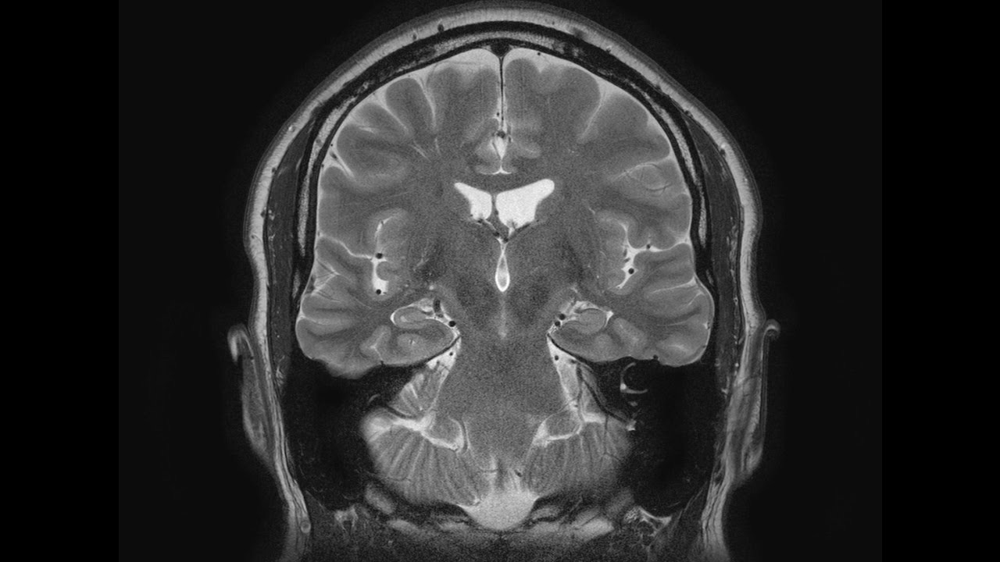

(1280, 720)

In [41]:
get_image_dimensions('./ImageData-Merge\\notumor\\Tr-no_0252.jpg')

The dimensions of the image are 900x741 (Width x Height).


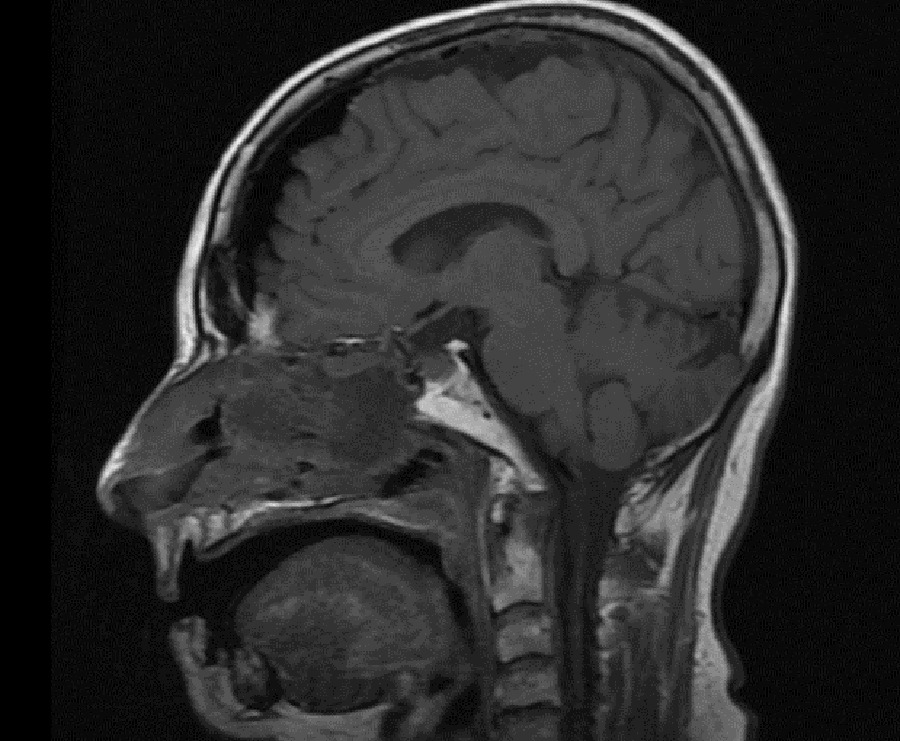

(900, 741)

In [42]:
get_image_dimensions('./ImageData-Merge\\pituitary\\Tr-pi_0044.jpg')

## Checking each individual folder

In [28]:
file_dimensions_outliers_glioma = analyze_file_dimensions('./ImageData-Merge/glioma')

# all of the images in the glioma folder have the same dimensions

Total files scanned: 1620

Dimension Counts:
- (512, 512): 1620 files

Width Statistics:
- Min width: 512
- Max width: 512
- Mean width: 512.00
- Median width: 512.00
- Std deviation: 0.00
- Mode width: 512

Height Statistics:
- Min height: 512
- Max height: 512
- Mean height: 512.00
- Median height: 512.00
- Std deviation: 0.00
- Mode height: 512

Total Outliers found: 0


In [29]:
file_dimensions_outliers_meningioma = analyze_file_dimensions('./ImageData-Merge/meningioma')

# most of the images in the meningioma folder have the same 512 dimensions but (1635 - 1384 = 251) 251 images have different dimensions.

Total files scanned: 1635

Dimension Counts:
- (512, 512): 1384 files
- (225, 225): 15 files
- (442, 442): 8 files
- (554, 554): 5 files
- (212, 237): 4 files
- (200, 223): 4 files
- (201, 251): 4 files
- (210, 240): 4 files
- (257, 307): 2 files
- (228, 221): 2 files
- (528, 581): 2 files
- (295, 394): 2 files
- (219, 234): 2 files
- (262, 308): 2 files
- (206, 249): 2 files
- (530, 526): 2 files
- (455, 500): 2 files
- (472, 546): 2 files
- (441, 427): 2 files
- (507, 605): 2 files
- (290, 339): 2 files
- (591, 650): 2 files
- (534, 674): 2 files
- (300, 345): 2 files
- (306, 306): 2 files
- (374, 370): 2 files
- (201, 207): 2 files
- (291, 340): 2 files
- (630, 423): 2 files
- (318, 354): 2 files
- (315, 341): 2 files
- (286, 356): 2 files
- (278, 306): 2 files
- (252, 303): 2 files
- (312, 401): 2 files
- (300, 412): 2 files
- (205, 251): 2 files
- (300, 258): 2 files
- (204, 249): 2 files
- (239, 224): 2 files
- (323, 342): 2 files
- (290, 342): 2 files
- (366, 395): 2 files
- (41

In [30]:
file_dimensions_outliers_notumor = analyze_file_dimensions('./ImageData-Merge/notumor')

# Most of the images in the 'no tumor' folder have variable dimensions.

Total files scanned: 1731

Dimension Counts:
- (225, 225): 305 files
- (630, 630): 80 files
- (201, 251): 49 files
- (300, 168): 49 files
- (232, 217): 48 files
- (228, 221): 48 files
- (150, 198): 43 files
- (200, 252): 40 files
- (428, 417): 40 files
- (236, 236): 39 files
- (227, 222): 38 files
- (173, 201): 36 files
- (206, 244): 34 files
- (192, 192): 31 files
- (442, 442): 30 files
- (218, 231): 28 files
- (201, 250): 27 files
- (227, 262): 26 files
- (215, 234): 26 files
- (208, 242): 24 files
- (468, 444): 23 files
- (504, 540): 23 files
- (642, 361): 22 files
- (359, 449): 22 files
- (214, 236): 21 files
- (400, 442): 19 files
- (236, 213): 19 files
- (442, 454): 17 files
- (230, 282): 17 files
- (393, 400): 17 files
- (207, 243): 17 files
- (441, 442): 16 files
- (276, 326): 16 files
- (420, 280): 16 files
- (235, 214): 16 files
- (512, 512): 16 files
- (550, 664): 16 files
- (194, 259): 15 files
- (680, 680): 14 files
- (339, 340): 13 files
- (380, 530): 12 files
- (275, 183

In [31]:
file_dimensions_outliers_pituitary = analyze_file_dimensions('./ImageData-Merge/pituitary')

# most of the images in the pituitary folder have the same 512 dimensions but (1740 - 1697 = 43) 43 images have different dimensions.

Total files scanned: 1740

Dimension Counts:
- (512, 512): 1697 files
- (256, 256): 28 files
- (474, 474): 2 files
- (400, 400): 1 files
- (685, 681): 1 files
- (202, 202): 1 files
- (1280, 1280): 1 files
- (442, 442): 1 files
- (502, 502): 1 files
- (360, 378): 1 files
- (721, 903): 1 files
- (1365, 1365): 1 files
- (470, 432): 1 files
- (940, 900): 1 files
- (201, 210): 1 files
- (900, 741): 1 files

Width Statistics:
- Min width: 201
- Max width: 1365
- Mean width: 508.88
- Median width: 512.00
- Std deviation: 46.61
- Mode width: 512

Height Statistics:
- Min height: 202
- Max height: 1365
- Mean height: 508.86
- Median height: 512.00
- Std deviation: 46.43
- Mode height: 512

Total Outliers found: 37


## Discovery

For file size I am looking specifically for anything larger than 1 MB file size, but it all seems manageable as no images are too large.  

It seems the image dimensions are all over the place and will have to resize them all to a standard. It seems the most common dimension is the 512x512 and will choose that as the new standard for all images. I thought about removing them but with are small data set of under 10K I believe all data is valuable.

Of all the outliers I looked at, yes they are different but all still useable. This will further not be an issue when we resize them. 

# Count Bar Graphs

To visually show the count and see if possible data imbalance.

In [43]:
def count_images_in_folder(folder_path):
    image_count = 0

    for root, _, files in os.walk(folder_path):  # Walk through folder and subfolders
        for file in files:
            file_path = os.path.join(root, file)
            try:
                # Try to open the file with Pillow to see if it's an image
                with PILImage.open(file_path) as img:
                    img.verify()  # Verify if it's a valid image
                image_count += 1
            except (IOError, SyntaxError):
                # Not an image or corrupted
                continue

    return image_count


def quick_plot_bar_graph(categories, values, figsize = (10, 6), title='Image Counts with Percentages', xlabel='Brain Tumor Types', ylabel='Count'):
    """
    Plots a bar graph with counts and percentages displayed on top of the bars.

    Parameters:
    - categories: List of category names (x-axis).
    - values: List of corresponding values (heights of the bars).
    """
    # Calculate total for percentage calculation
    total = sum(values)
    
    # Plot the bar graph
    plt.figure(figsize=figsize)
    bars = plt.bar(categories, values, color='skyblue')

    # Add count and percentage on top of each bar
    for bar, value in zip(bars, values):
        height = bar.get_height()
        percentage = (value / total) * 100
        plt.text(bar.get_x() + bar.get_width() / 2, height, 
                 f'{value}\n({percentage:.1f}%)', 
                 ha='center', va='bottom', fontsize=10)

    # Add titles and labels
    plt.title(title, fontsize=16)
    plt.xlabel(xlabel, fontsize=12)
    plt.ylabel(ylabel, fontsize=12)

    # Show the plot
    plt.show()


In [44]:
# get the count of images in each folder

image_count_glioma = count_images_in_folder('./ImageData-Merge/glioma')

image_count_meningioma = count_images_in_folder('./ImageData-Merge/meningioma')

image_count_notumor = count_images_in_folder('./ImageData-Merge/notumor')

image_count_pituitary = count_images_in_folder('./ImageData-Merge/pituitary')

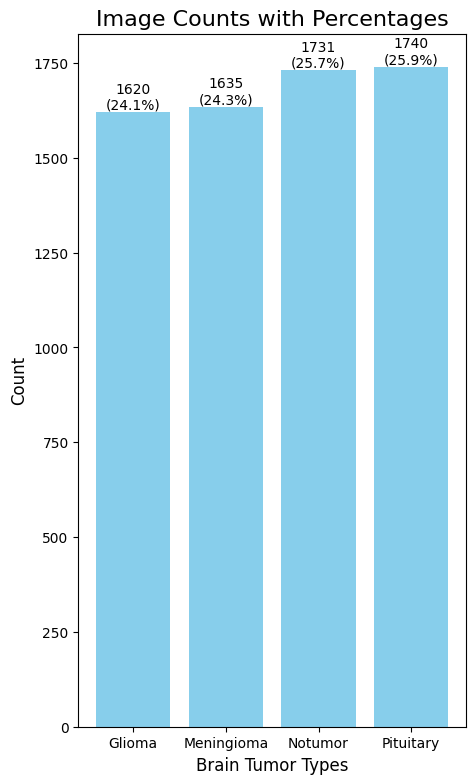

In [45]:
# 4 classes

categories = ['Glioma', 'Meningioma', 'Notumor', 'Pituitary']
values = [image_count_glioma, image_count_meningioma, image_count_notumor, image_count_pituitary]

quick_plot_bar_graph(categories, values,figsize=(5,9))

# Honestly each class are pretty balanced, except for the notumor class which has a bit more images.

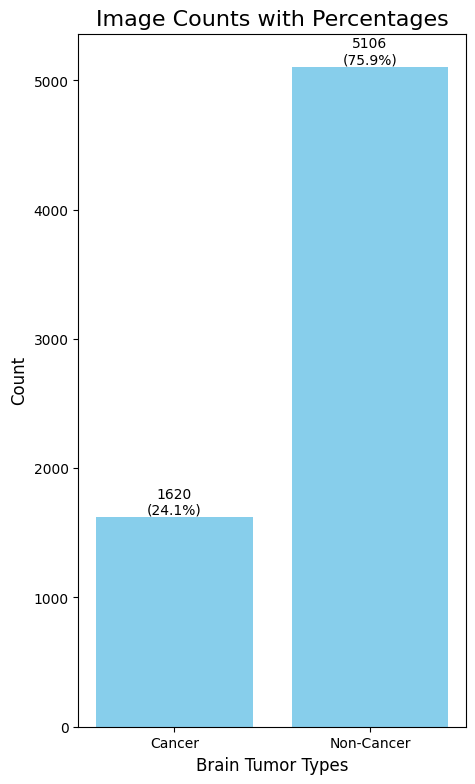

In [46]:
# 2 classes - merged all non cancer classes together

categories = ['Cancer', 'Non-Cancer']
values = [image_count_glioma, image_count_meningioma + image_count_notumor + image_count_pituitary]

quick_plot_bar_graph(categories, values,figsize=(5,9))

## Discovery

if merge there is definitely a class imbalance that I will have to address.

# Scale & Threshold

In [52]:
def scale_images(folder_path, output_path, lower=0.0, upper=1.0):
    """
    Scales the pixel values of all images in the folder structure to a defined range [lower, upper].
    Adds a '_scaled' suffix to the processed image filenames.
    """
    # Create output directory structure
    for root, dirs, files in os.walk(folder_path):
        for dir_name in dirs:
            os.makedirs(os.path.join(output_path, os.path.relpath(os.path.join(root, dir_name), folder_path)), exist_ok=True)

    # Process and save scaled images
    for root, dirs, files in os.walk(folder_path):
        for file in files:
            if file.lower().endswith(('jpg', 'jpeg', 'png', 'bmp', 'tif', 'tiff', 'webp')):
                try:
                    image_path = os.path.join(root, file)
                    with PILImage.open(image_path) as img:
                        # Convert to NumPy array for scaling
                        img_array = np.asarray(img).astype(np.float32) / 255.0  # Normalize to [0, 1]
                        img_array = np.clip(img_array, lower, upper)  # Apply thresholding

                        # Convert back to PIL Image
                        scaled_img = PILImage.fromarray((img_array * 255).astype(np.uint8))

                        # Save image with '_scaled' suffix
                        original_file_name = os.path.basename(image_path)
                        file_name, ext = os.path.splitext(original_file_name)
                        new_file_name = f"{file_name}_scaled{ext}"
                        save_dir = os.path.join(output_path, os.path.relpath(root, folder_path))
                        save_path = os.path.join(save_dir, new_file_name)

                        scaled_img.save(save_path)
                        print(f"Saved: {save_path}")
                except Exception as e:
                    print(f"Error processing {image_path}: {e}")


In [ ]:
# go through all the images and scale their pixel values to be between 0 and 1, ensures all pixel values are in a uniform range, making it easier for the algorithm to process the data consistently.
scale_images(
    folder_path='./ImageData-Merge',
    output_path='./ImageData-Merge_Scaled',
    lower=0.0,
    upper=1.0,
)

Saved: ./ImageData-Merge_Scaled\glioma\Te-glTr_0000_scaled.jpg
Saved: ./ImageData-Merge_Scaled\glioma\Te-glTr_0001_scaled.jpg
Saved: ./ImageData-Merge_Scaled\glioma\Te-glTr_0002_scaled.jpg
Saved: ./ImageData-Merge_Scaled\glioma\Te-glTr_0003_scaled.jpg
Saved: ./ImageData-Merge_Scaled\glioma\Te-glTr_0004_scaled.jpg
Saved: ./ImageData-Merge_Scaled\glioma\Te-glTr_0005_scaled.jpg
Saved: ./ImageData-Merge_Scaled\glioma\Te-glTr_0006_scaled.jpg
Saved: ./ImageData-Merge_Scaled\glioma\Te-glTr_0007_scaled.jpg
Saved: ./ImageData-Merge_Scaled\glioma\Te-glTr_0008_scaled.jpg
Saved: ./ImageData-Merge_Scaled\glioma\Te-glTr_0009_scaled.jpg
Saved: ./ImageData-Merge_Scaled\glioma\Te-gl_0010_scaled.jpg
Saved: ./ImageData-Merge_Scaled\glioma\Te-gl_0011_scaled.jpg
Saved: ./ImageData-Merge_Scaled\glioma\Te-gl_0012_scaled.jpg
Saved: ./ImageData-Merge_Scaled\glioma\Te-gl_0013_scaled.jpg
Saved: ./ImageData-Merge_Scaled\glioma\Te-gl_0014_scaled.jpg
Saved: ./ImageData-Merge_Scaled\glioma\Te-gl_0015_scaled.jpg
Save

# Resize

## Attempt 1 - Only Resize

In [59]:
def resize_images(folder_path, output_path, new_size=(256, 256)):
    """
    Resizes all images in the folder structure to the specified dimensions (new_size).
    Adds a '_resized_WIDTHxHEIGHT' suffix to the processed image filenames.
    """
    # Create output directory structure
    for root, dirs, files in os.walk(folder_path):
        for dir_name in dirs:
            os.makedirs(os.path.join(output_path, os.path.relpath(os.path.join(root, dir_name), folder_path)), exist_ok=True)

    # Process and save resized images
    for root, dirs, files in os.walk(folder_path):
        for file in files:
            if file.lower().endswith(('jpg', 'jpeg', 'png', 'bmp', 'tif', 'tiff', 'webp')):
                try:
                    image_path = os.path.join(root, file)
                    with PILImage.open(image_path) as img:
                        # Resize image
                        resized_img = img.resize(new_size, PILImage.ANTIALIAS)

                        # Save image with '_resized_WIDTHxHEIGHT' suffix
                        original_file_name = os.path.basename(image_path)
                        file_name, ext = os.path.splitext(original_file_name)
                        new_file_name = f"{file_name}_resized_{new_size[0]}x{new_size[1]}{ext}"
                        save_dir = os.path.join(output_path, os.path.relpath(root, folder_path))
                        save_path = os.path.join(save_dir, new_file_name)

                        resized_img.save(save_path)
                        print(f"Saved: {save_path}")
                except Exception as e:
                    print(f"Error processing {image_path}: {e}")

In [ ]:
# go through all the images and resize them to 512x512
resize_images(
    folder_path='./ImageData-Merge_Scaled',
    output_path='./ImageData-Merge_Scaled_Resized',
    new_size=(512, 512)
)

C:\Users\aero9\AppData\Local\Temp\ipykernel_53300\1535103953.py:56: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  resized_img = img.resize(new_size, PILImage.ANTIALIAS)


Saved: ./ImageData-Merge_Scaled_Resized\glioma\Te-glTr_0000_scaled_resized_512x512.jpg
Saved: ./ImageData-Merge_Scaled_Resized\glioma\Te-glTr_0001_scaled_resized_512x512.jpg
Saved: ./ImageData-Merge_Scaled_Resized\glioma\Te-glTr_0002_scaled_resized_512x512.jpg
Saved: ./ImageData-Merge_Scaled_Resized\glioma\Te-glTr_0003_scaled_resized_512x512.jpg
Saved: ./ImageData-Merge_Scaled_Resized\glioma\Te-glTr_0004_scaled_resized_512x512.jpg
Saved: ./ImageData-Merge_Scaled_Resized\glioma\Te-glTr_0005_scaled_resized_512x512.jpg
Saved: ./ImageData-Merge_Scaled_Resized\glioma\Te-glTr_0006_scaled_resized_512x512.jpg
Saved: ./ImageData-Merge_Scaled_Resized\glioma\Te-glTr_0007_scaled_resized_512x512.jpg
Saved: ./ImageData-Merge_Scaled_Resized\glioma\Te-glTr_0008_scaled_resized_512x512.jpg
Saved: ./ImageData-Merge_Scaled_Resized\glioma\Te-glTr_0009_scaled_resized_512x512.jpg
Saved: ./ImageData-Merge_Scaled_Resized\glioma\Te-gl_0010_scaled_resized_512x512.jpg
Saved: ./ImageData-Merge_Scaled_Resized\gliom

Example of before and after upscaling to represent for some of the data. The upscale image is a bit blurry but doesn't seem that bad as just by looking at it I still get the general shapes and structures of the brain. So it is still useable.

The dimensions of the image are 1280x720 (Width x Height).


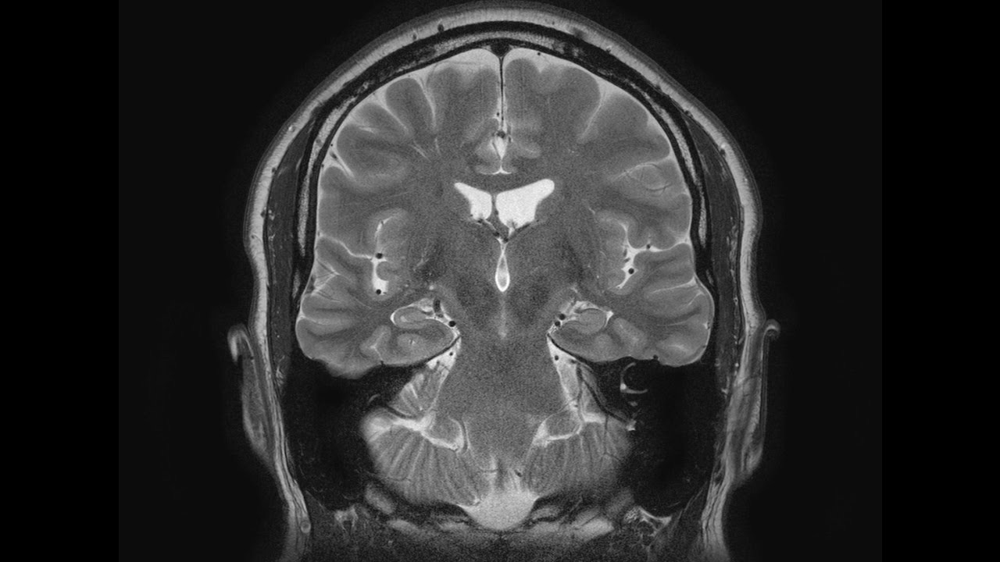

(1280, 720)

In [54]:
# Before resizing, original dimensions
get_image_dimensions('./ImageData-Merge\\notumor\\Tr-no_0252.jpg')

The dimensions of the image are 512x512 (Width x Height).


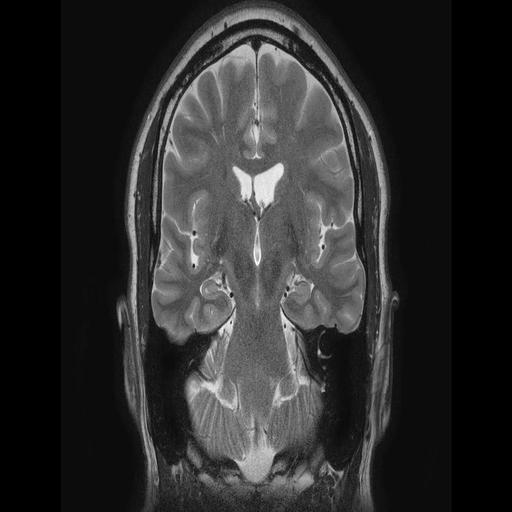

(512, 512)

In [57]:
# After resizing
get_image_dimensions('./ImageData-Merge_Scaled_Resized\\notumor\\Tr-no_0252_scaled_resized_512x512.jpg')

## Attempt 2 - Crop & Resize

In [ ]:
# The previous resize method was not working as expected as some images are too squished,
# so I will use the following method to resize the images.

In [73]:
def crop_to_square(image_path, output_path):
    """
    Crops the given image to a square format based on the smallest dimension.
    """
    with PILImage.open(image_path) as img:
        width, height = img.size
        if width == height:
            # Already a square, copy directly
            img.save(output_path)
            return

        # Determine the size of the square (smallest dimension)
        square_size = min(width, height)
        
        # Calculate cropping box
        left = (width - square_size) // 2
        top = (height - square_size) // 2
        right = left + square_size
        bottom = top + square_size

        # Crop and save the image
        cropped_img = img.crop((left, top, right, bottom))
        cropped_img.save(output_path)

def crop_to_square_all(input_folder, output_folder):
    """
    Processes all images in the input folder and its subfolders, cropping them to squares.
    """
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)

    for root, _, files in os.walk(input_folder):
        # Create corresponding output directory
        relative_path = os.path.relpath(root, input_folder)
        output_subfolder = os.path.join(output_folder, relative_path)
        if not os.path.exists(output_subfolder):
            os.makedirs(output_subfolder)

        for file in files:
            input_file_path = os.path.join(root, file)
            file_name, file_ext = os.path.splitext(file)
            output_file_name = f"{file_name}_cropped{file_ext}"
            output_file_path = os.path.join(output_subfolder, output_file_name)

            # Process only valid image files
            try:
                crop_to_square(input_file_path, output_file_path)
            except Exception as e:
                print(f"Skipping file {input_file_path}: {e}")

In [74]:
crop_to_square_all('./ImageData-Merge_Scaled', './ImageData-Merge_Scaled_Cropped')

The dimensions of the image are 1280x720 (Width x Height).


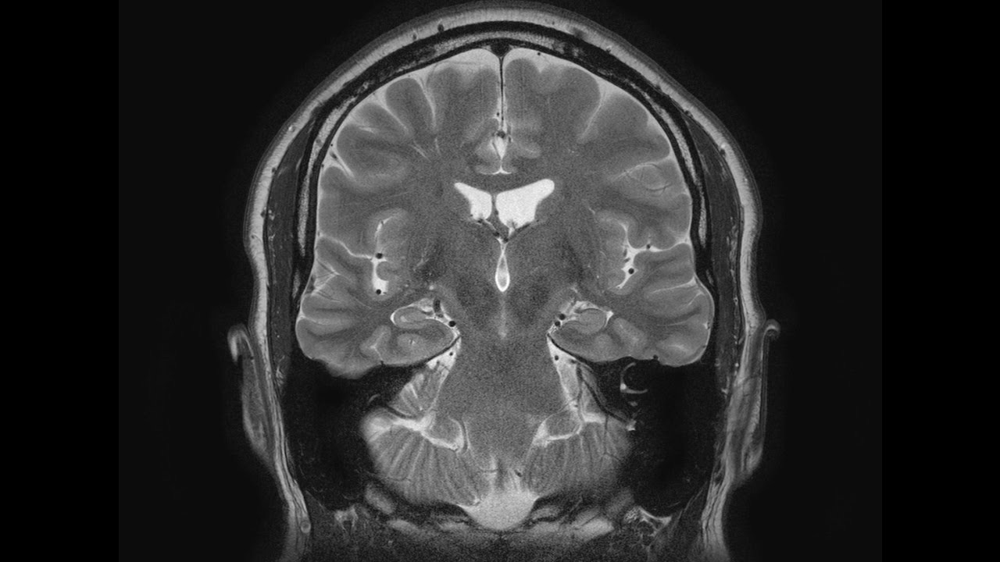

(1280, 720)

In [75]:
# Before cropping,
get_image_dimensions('./ImageData-Merge\\notumor\\Tr-no_0252.jpg')

The dimensions of the image are 720x720 (Width x Height).


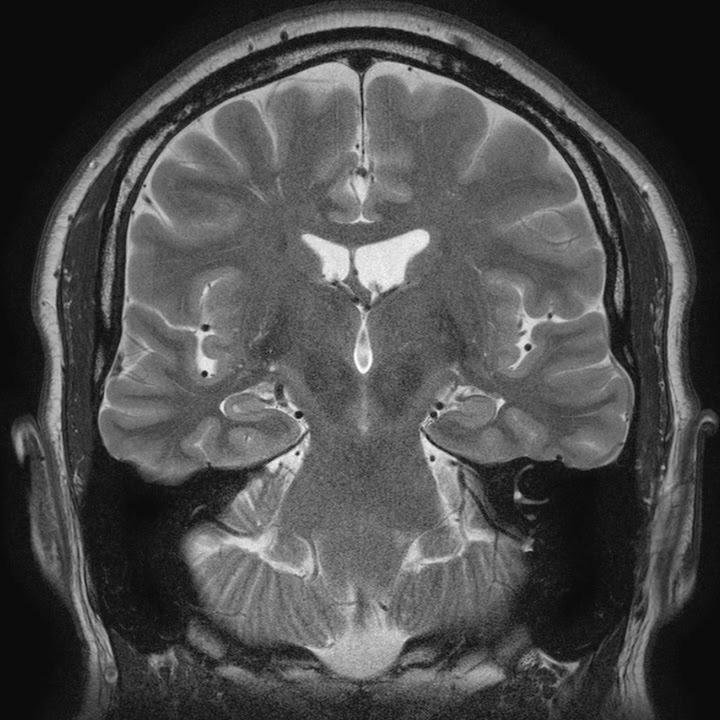

(720, 720)

In [76]:
# After cropping
get_image_dimensions('./ImageData-Merge_Scaled_Cropped\\notumor\\Tr-no_0252_scaled_cropped.jpg')

# Looks good now! Of course some other images will be cropped too much but that is fine as the tumor region will most likely be in the center.

In [77]:
# go through all the images and resize them to 512x512
resize_images(
    folder_path='./ImageData-Merge_Scaled_Cropped',
    output_path='./ImageData-Merge_Scaled_Cropped_Resize2',
    new_size=(512, 512)
)

C:\Users\aero9\AppData\Local\Temp\ipykernel_53300\1146092894.py:19: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  resized_img = img.resize(new_size, PILImage.ANTIALIAS)


Saved: ./ImageData-Merge_Scaled_Cropped_Resize2\glioma\Te-glTr_0000_scaled_cropped_resized_512x512.jpg
Saved: ./ImageData-Merge_Scaled_Cropped_Resize2\glioma\Te-glTr_0001_scaled_cropped_resized_512x512.jpg
Saved: ./ImageData-Merge_Scaled_Cropped_Resize2\glioma\Te-glTr_0002_scaled_cropped_resized_512x512.jpg
Saved: ./ImageData-Merge_Scaled_Cropped_Resize2\glioma\Te-glTr_0003_scaled_cropped_resized_512x512.jpg
Saved: ./ImageData-Merge_Scaled_Cropped_Resize2\glioma\Te-glTr_0004_scaled_cropped_resized_512x512.jpg
Saved: ./ImageData-Merge_Scaled_Cropped_Resize2\glioma\Te-glTr_0005_scaled_cropped_resized_512x512.jpg
Saved: ./ImageData-Merge_Scaled_Cropped_Resize2\glioma\Te-glTr_0006_scaled_cropped_resized_512x512.jpg
Saved: ./ImageData-Merge_Scaled_Cropped_Resize2\glioma\Te-glTr_0007_scaled_cropped_resized_512x512.jpg
Saved: ./ImageData-Merge_Scaled_Cropped_Resize2\glioma\Te-glTr_0008_scaled_cropped_resized_512x512.jpg
Saved: ./ImageData-Merge_Scaled_Cropped_Resize2\glioma\Te-glTr_0009_scale

The dimensions of the image are 1280x720 (Width x Height).


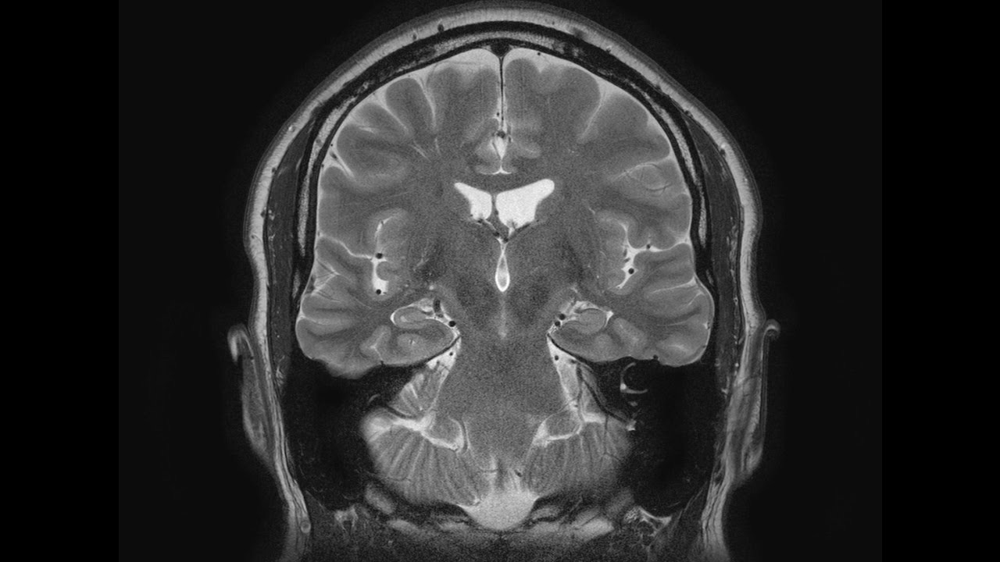

(1280, 720)

In [78]:
# Before resize,
get_image_dimensions('./ImageData-Merge\\notumor\\Tr-no_0252.jpg')

The dimensions of the image are 512x512 (Width x Height).


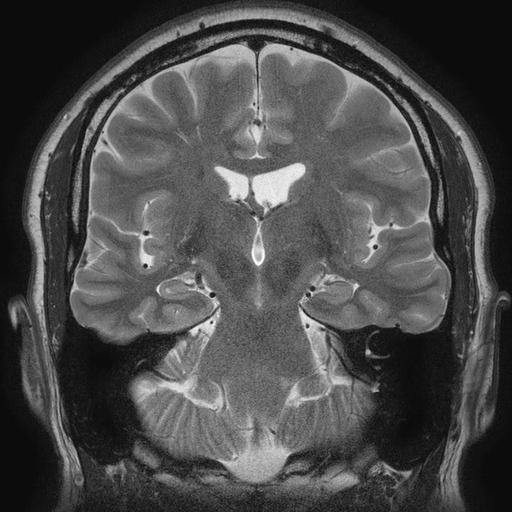

(512, 512)

In [80]:
# After resize
get_image_dimensions('./ImageData-Merge_Scaled_Cropped_Resize2\\notumor\\Tr-no_0252_scaled_cropped_resized_512x512.jpg')

# Looks good now! Of course some other images will be cropped too much but that is fine as the tumor region will most likely be in the center.

In [81]:
# Everything looks good.
# Now making a new directory for the resized images
ImageDataMergePathCleaned = 'ImageData-Merge_Scaled_Cropped_Resize2'

# Check for blurry images

After scaling and resizing the image, will have to check if blurry. If blurry then will have to inspect by eye if still good enough for the AI to use. 

The script uses the Laplacian variance method, a common technique for detecting image blur.

In [82]:
import os
import cv2

def detect_blurry_images(image_directory, threshold=100):
    """
    Detects blurry or low-quality images in the specified directory.

    Args:
        image_directory (str): Path to the directory containing images.
        threshold (float): Variance of the Laplacian below which an image is considered blurry. Default is 100.

    Returns:
        list: A list of paths to images considered blurry or low quality.
    """
    blurry_images = []
    total_files_scanned = 0

    # Scan through the directory for image files
    for root, _, files in os.walk(image_directory):
        for file in files:
            # Build full file path
            file_path = os.path.join(root, file)

            # Read the image
            image = cv2.imread(file_path)
            if image is None:
                print(f"Skipped non-image file: {file_path}")
                continue

            # Convert to grayscale
            gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

            # Calculate the variance of the Laplacian
            laplacian_var = cv2.Laplacian(gray, cv2.CV_64F).var()

            # Check if the image is blurry
            if laplacian_var < threshold:
                blurry_images.append(file_path)

            total_files_scanned += 1

            # Output feedback periodically
            if total_files_scanned % 10 == 0:
                print(f"Scanned {total_files_scanned} images...")

    print(f"Total files scanned: {total_files_scanned}")
    print(f"Blurry images found: {len(blurry_images)}")
    return blurry_images

In [89]:
blurry_images = detect_blurry_images(ImageDataMergePathCleaned,threshold = 10)
blurry_images

Scanned 10 images...
Scanned 20 images...
Scanned 30 images...
Scanned 40 images...
Scanned 50 images...
Scanned 60 images...
Scanned 70 images...
Scanned 80 images...
Scanned 90 images...
Scanned 100 images...
Scanned 110 images...
Scanned 120 images...
Scanned 130 images...
Scanned 140 images...
Scanned 150 images...
Scanned 160 images...
Scanned 170 images...
Scanned 180 images...
Scanned 190 images...
Scanned 200 images...
Scanned 210 images...
Scanned 220 images...
Scanned 230 images...
Scanned 240 images...
Scanned 250 images...
Scanned 260 images...
Scanned 270 images...
Scanned 280 images...
Scanned 290 images...
Scanned 300 images...
Scanned 310 images...
Scanned 320 images...
Scanned 330 images...
Scanned 340 images...
Scanned 350 images...
Scanned 360 images...
Scanned 370 images...
Scanned 380 images...
Scanned 390 images...
Scanned 400 images...
Scanned 410 images...
Scanned 420 images...
Scanned 430 images...
Scanned 440 images...
Scanned 450 images...
Scanned 460 images.

['ImageData-Merge_Scaled_Cropped_Resize2\\glioma\\Tr-gl_0829_scaled_cropped_resized_512x512.jpg',
 'ImageData-Merge_Scaled_Cropped_Resize2\\meningioma\\Tr-me_0361_scaled_cropped_resized_512x512.jpg',
 'ImageData-Merge_Scaled_Cropped_Resize2\\notumor\\Te-noTr_0007_scaled_cropped_resized_512x512.jpg',
 'ImageData-Merge_Scaled_Cropped_Resize2\\notumor\\Tr-no_0052_scaled_cropped_resized_512x512.jpg']

The dimensions of the image are 512x512 (Width x Height).


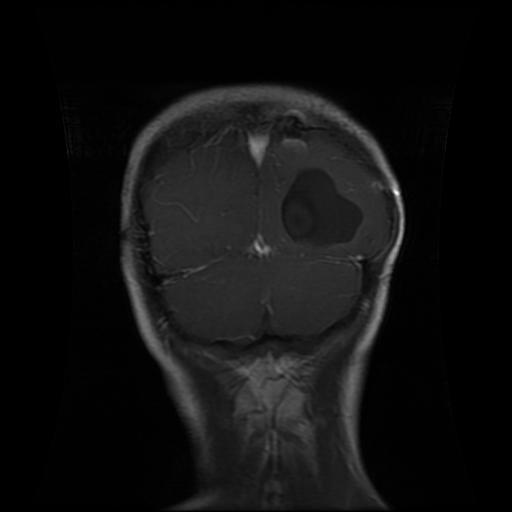

(512, 512)

In [90]:
# Blur image 1
get_image_dimensions('ImageData-Merge_Scaled_Cropped_Resize2\\glioma\\Tr-gl_0829_scaled_cropped_resized_512x512.jpg')

The dimensions of the image are 512x512 (Width x Height).


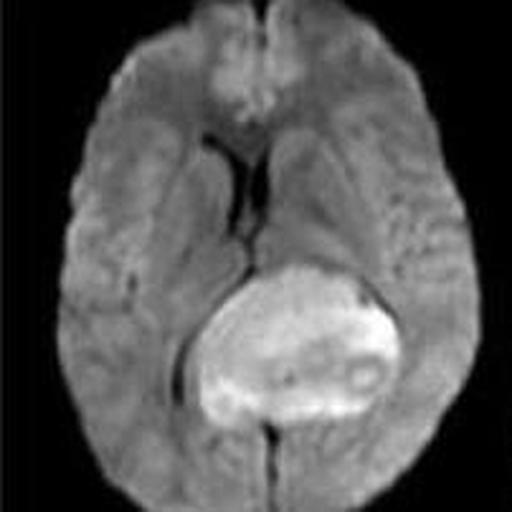

(512, 512)

In [91]:
# Blur image 2
get_image_dimensions('ImageData-Merge_Scaled_Cropped_Resize2\\meningioma\\Tr-me_0361_scaled_cropped_resized_512x512.jpg')

The dimensions of the image are 512x512 (Width x Height).


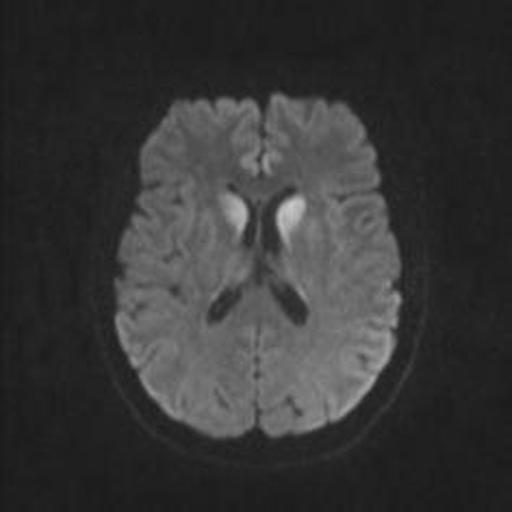

(512, 512)

In [92]:
# Blur image 1
get_image_dimensions('ImageData-Merge_Scaled_Cropped_Resize2\\notumor\\Te-noTr_0007_scaled_cropped_resized_512x512.jpg')

The dimensions of the image are 512x512 (Width x Height).


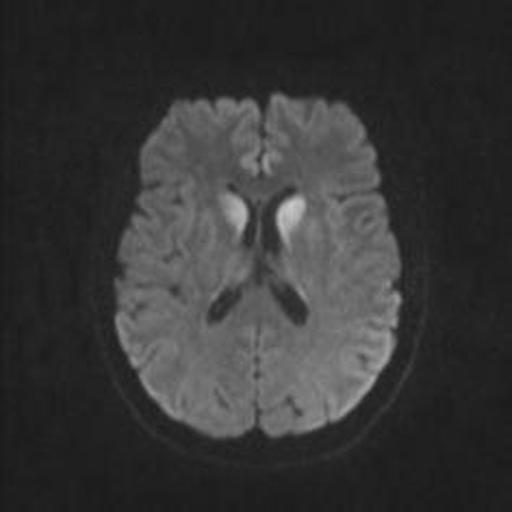

(512, 512)

In [93]:
# Blur image 4
get_image_dimensions('ImageData-Merge_Scaled_Cropped_Resize2\\notumor\\Tr-no_0052_scaled_cropped_resized_512x512.jpg')

# interestingly this image looks like a duplicate of the previous image; so I guess there is some slight modification in the image 
# or maybe previous uncropped form was different, that that duplicate removal process let it passed.

In [95]:
# those images are indeed blurry, so I will delete them.
delete_images(blurry_images)

Successfully deleted: ImageData-Merge_Scaled_Cropped_Resize2\glioma\Tr-gl_0829_scaled_cropped_resized_512x512.jpg
Successfully deleted: ImageData-Merge_Scaled_Cropped_Resize2\meningioma\Tr-me_0361_scaled_cropped_resized_512x512.jpg
Successfully deleted: ImageData-Merge_Scaled_Cropped_Resize2\notumor\Te-noTr_0007_scaled_cropped_resized_512x512.jpg
Successfully deleted: ImageData-Merge_Scaled_Cropped_Resize2\notumor\Tr-no_0052_scaled_cropped_resized_512x512.jpg


In [96]:
# test if images are deleted.
get_image_dimensions('ImageData-Merge_Scaled_Cropped_Resize2\\notumor\\Tr-no_0052_scaled_cropped_resized_512x512.jpg')

# Yes they are deleted.

Error: The specified file was not found. Please check the file path and try again.


## Discovery 

I originally set the threshold to 50 and checked the images and they all looked all right and kept lowering the threshold. Threshold 10 is the lowest and after that says no there are no blurry images. Even on threshold 10 the images are not that bad that the AI will have issues as the CNN will be able to focus on the general shapes and the blurs are not too bleeding to ruin the shapes.

It was only at threshold 10 where the images seems to be really blurry that can't really get much intel from it.

# Segmentation

We are doing image classification instead of image segmentation models so no need to segment the data.

Also we are on a tight schedule to complete out company goals, and do not have the man power nor time to segment all those image datas by hand.

But such an option is definitely possible in future if the company would like to make a more upgraded brain tumor detection model. 

# Transformation & Augmentation

We are under 10K data which is pretty small and thus one method to increase the number of image data is with image augmentation. This can be done by mirroring the image in different ways or other effects as a valid way to increase the models recognization of bran and tumor images from potential different perspective.

In [104]:
def flip_image(image, direction='horizontal'):
    """Flip the image up or down ('vertical') or left to right ('horizontal')."""
    if direction == 'vertical':
        return ImageOps.flip(image)
    elif direction == 'horizontal':
        return ImageOps.mirror(image)
    else:
        raise ValueError("Direction must be 'vertical' or 'horizontal'")

def rotate_image(image, angle):
    """Rotate the image by a specific angle."""
    return image.rotate(angle, expand=True)

def augment_image(image):
    """Perform all augmentations: flips and rotations."""
    augmented_images = []

    # Original image
    augmented_images.append(image)

    # Flips without rotation
    flipped_vertical = flip_image(image, 'vertical')
    flipped_horizontal = flip_image(image, 'horizontal')
    augmented_images.extend([flipped_vertical, flipped_horizontal])

    # Rotations (0, 90, 180, 270 degrees) with and without flips
    for angle in [0, 90, 180, 270]:
        rotated = rotate_image(image, angle)
        augmented_images.append(rotated)  # Add rotations of the original

        # Add rotations of flipped images
        if angle != 0:  # Skip duplicate original (0 degrees)
            augmented_images.append(rotate_image(flipped_vertical, angle))
            augmented_images.append(rotate_image(flipped_horizontal, angle))

    return augmented_images

def augment_image_all(input_folder, output_folder):
    """
    Process all images in a folder and its subfolders,
    apply augmentations, and save them to the output folder.
    """
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)

    for root, _, files in os.walk(input_folder):
        for file in files:
            if file.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp', '.tiff')):
                input_path = os.path.join(root, file)
                rel_path = os.path.relpath(root, input_folder)
                output_subfolder = os.path.join(output_folder, rel_path)
                os.makedirs(output_subfolder, exist_ok=True)

                try:
                    # Open the image
                    image = PILImage.open(input_path)

                    # Generate augmented images
                    augmented_images = augment_image(image)

                    # Save each augmented image
                    base_name, ext = os.path.splitext(file)
                    for i, img in enumerate(augmented_images):
                        output_path = os.path.join(output_subfolder, f"{base_name}_aug_{i}{ext}")
                        img.save(output_path)

                    print(f"Processed: {input_path}")

                except Exception as e:
                    print(f"Error processing {input_path}: {e}")

In [105]:
augment_image_all(ImageDataMergePathCleaned, './ImageData-Merge_Scaled_Cropped_Resize2_Augmented')

Processed: ImageData-Merge_Scaled_Cropped_Resize2\glioma\Te-glTr_0000_scaled_cropped_resized_512x512.jpg
Processed: ImageData-Merge_Scaled_Cropped_Resize2\glioma\Te-glTr_0001_scaled_cropped_resized_512x512.jpg
Processed: ImageData-Merge_Scaled_Cropped_Resize2\glioma\Te-glTr_0002_scaled_cropped_resized_512x512.jpg
Processed: ImageData-Merge_Scaled_Cropped_Resize2\glioma\Te-glTr_0003_scaled_cropped_resized_512x512.jpg
Processed: ImageData-Merge_Scaled_Cropped_Resize2\glioma\Te-glTr_0004_scaled_cropped_resized_512x512.jpg
Processed: ImageData-Merge_Scaled_Cropped_Resize2\glioma\Te-glTr_0005_scaled_cropped_resized_512x512.jpg
Processed: ImageData-Merge_Scaled_Cropped_Resize2\glioma\Te-glTr_0006_scaled_cropped_resized_512x512.jpg
Processed: ImageData-Merge_Scaled_Cropped_Resize2\glioma\Te-glTr_0007_scaled_cropped_resized_512x512.jpg
Processed: ImageData-Merge_Scaled_Cropped_Resize2\glioma\Te-glTr_0008_scaled_cropped_resized_512x512.jpg
Processed: ImageData-Merge_Scaled_Cropped_Resize2\gliom

In [ ]:
# Count images before augmentation
count_images_in_folder('./ImageData-Merge')

6726

In [107]:
# Count images after augmentation
count_images_in_folder('./ImageData-Merge_Scaled_Cropped_Resize2_Augmented')

87347

## Discovery

Before we were under 10K data which makes our data set small.

Thanks to augmentation, we are now above 10k data. 

Also augmentation will our model to understand a a brain MRI scan from different angles of the general shape.

Also if we decide to merge the brain tumor classes it will have imbalance data, this augmentation allows us the flexibility to balance the data.